[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/philschmid/gemini-2.5-ai-engineering-workshop/blob/main/notebooks/02-multimodal-capabilities.ipynb)

# Part 2 - Multimodal Capabilities (Images, Audio, Video, Documents)

Gemini models like `gemini-2.5-flash-preview-05-20` can process text, images, audio, video, and documents in a single prompt using `client.models.generate_content()`. This enables powerful multimodal AI applications that can understand and generate content across different media types.

**Key Capabilities:**
- **Visual Understanding**: Analyze images, extract text, identify objects
- **Audio Processing**: Transcribe speech, analyze music, understand audio content
- **Video Analysis**: Summarize videos, extract key frames, understand motion
- **Document Processing**: Extract information from PDFs, understand layouts
- **Multimodal Generation**: Create images and speech from text prompts

In [2]:
%pip install pillow

Note: you may need to restart the kernel to use updated packages.


In [3]:
from google import genai
from google.genai import types
import os
import sys
import requests
from PIL import Image
from io import BytesIO

IN_COLAB = 'google.colab' in sys.modules

if IN_COLAB:
    from google.colab import userdata
    GEMINI_API_KEY = userdata.get('GEMINI_API_KEY')
else:
    GEMINI_API_KEY = os.environ.get('GEMINI_API_KEY',None)

# Create client with api key
MODEL_ID = "gemini-2.5-flash-preview-05-20"
client = genai.Client(api_key=GEMINI_API_KEY)

## 1. Image Understanding: Single Image

Gemini can analyze images in multiple formats: PIL `Image` objects, raw bytes, or uploaded files via the File API.

**When to use each method:**
- **Raw bytes**: When working with image data from APIs or memory
- **File API**: Large images (>20MB), when you want to reuse images across multiple requests

In [4]:
!curl -o image.jpg "https://storage.googleapis.com/generativeai-downloads/images/Cupcakes.jpg"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1582k  100 1582k    0     0  3007k      0 --:--:-- --:--:-- --:--:-- 3013k


In [5]:
with open('image.jpg', 'rb') as f:
    image_bytes = f.read()

prompt_specific = "Are there any fruits visible?"

response_specific = client.models.generate_content(
    model=MODEL_ID,
    contents=["What is this image?",
            types.Part.from_bytes(data=image_bytes, mime_type="image/jpeg")]
)
print(response_specific.text)

This is a vibrant image showcasing numerous freshly baked and decorated cupcakes arranged on a rustic wooden table, surrounded by various baking tools and ingredients.

Here's a detailed description:

*   **Cupcakes:** There are approximately 15-16 visible cupcakes, each uniquely decorated. Many of them feature whimsical "googly eyes," giving them a playful, monster-like appearance. The cupcakes display a variety of frosting colors, including pink, white, chocolate brown, bright yellow, and red. They are adorned with a generous amount of colorful sprinkles, sugar beads, and some have chocolate shavings or solid colored frosting. Some appear to be chocolate cake, while others are lighter, possibly vanilla or yellow cake.
*   **Setting:** The cupcakes are scattered across a warm-toned wooden table or countertop. There are visible dustings of white powder, likely flour or powdered sugar, on the surface, suggesting an active baking or decorating session.
*   **Background Elements:**
    * 

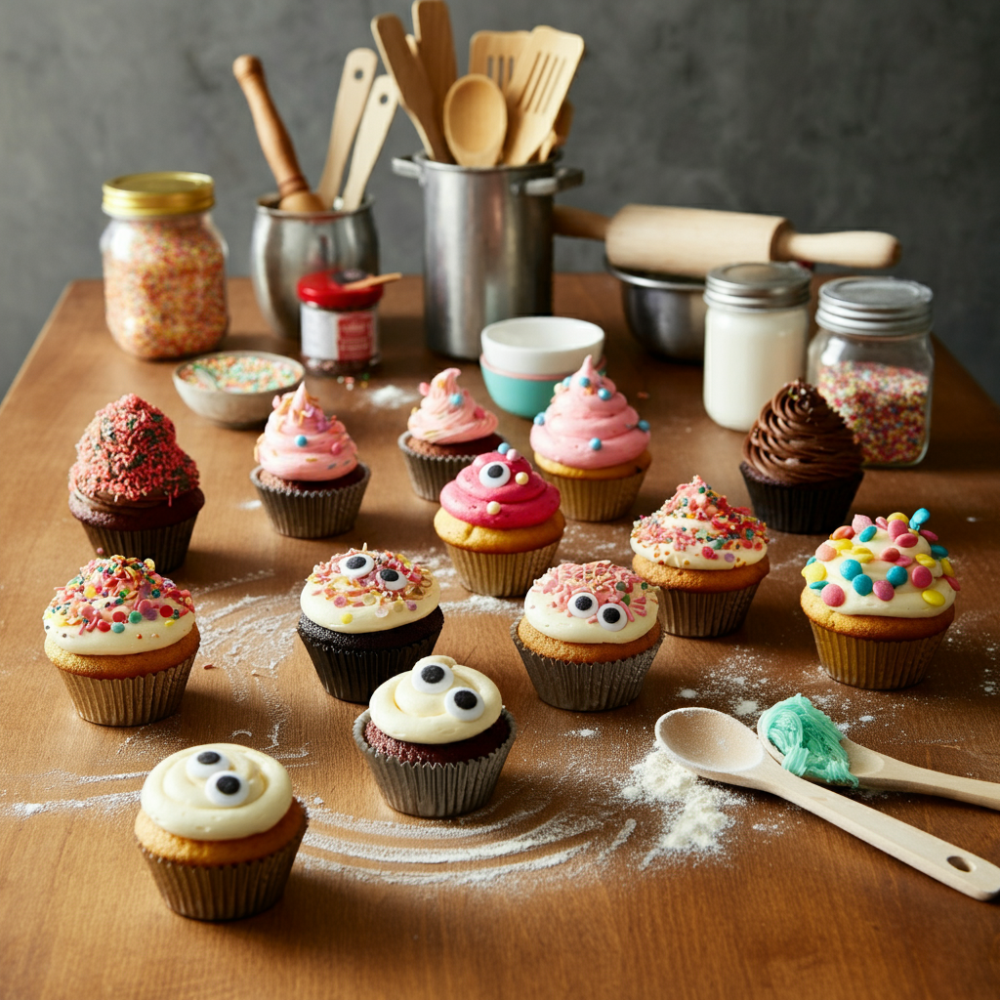

In [6]:
from PIL import Image

img = Image.open('image.jpg')
img

You can use the File API for large payloads (>20MB).

> The File API lets you store up to 20 GB of files per project, with a per-file maximum size of 2 GB. Files are stored for 48 hours. They can be accessed in that period with your API key, but cannot be downloaded from the API. It is available at no cost in all regions where the Gemini API is available.

In [7]:
file_id = client.files.upload(file="../assets/data/Cupcakes.jpg")

response = client.models.generate_content(
    model=MODEL_ID,
    contents=["What is this image?", file_id]
)

print(response.text)

This image is a brightly lit still life of various decorated cupcakes and baking supplies on a wooden table, suggesting a fun, ongoing baking or decorating session.

Here's a detailed description:

*   **Main Subject:** A collection of numerous freshly baked and decorated cupcakes are spread across a light brown wooden table.
*   **Cupcake Variety:** The cupcakes feature different colored frostings (including pink, red, white, and chocolate) and a variety of toppings. Many are adorned with colorful sprinkles, while several have whimsical "googly" candy eyes, giving them a playful, monster-like appearance. Other toppings include small round candies.
*   **Baking & Decorating Supplies:** Surrounding the cupcakes are various baking tools and ingredients. These include:
    *   Large glass jars filled with an abundance of colorful sprinkles.
    *   A rolling pin.
    *   Metal containers holding wooden kitchen utensils (spatulas, spoons).
    *   Smaller bowls, some empty, one containing 

> The File API lets you store up to 20 GB of files per project, with a per-file maximum size of 2 GB. Files are stored for 48 hours. They can be accessed in that period with your API key, but cannot be downloaded from the API. It is available at no cost in all regions where the Gemini API is available.

## 2. Image Understanding: Multiple Images

Gemini can analyze and compare multiple images simultaneously, which is powerful for comparative analysis, visual storytelling, or understanding sequences.

In [8]:
image_url_1 = "https://plus.unsplash.com/premium_photo-1694819488591-a43907d1c5cc?fm=jpg&q=60&w=3000&ixlib=rb-4.1.0&ixid=M3wxMjA3fDB8MHxzZWFyY2h8MXx8Y3V0ZSUyMGRvZ3xlbnwwfHwwfHx8MA%3D%3D" # Dog
image_url_2 = "https://images.pexels.com/photos/2071882/pexels-photo-2071882.jpeg?auto=compress&cs=tinysrgb&dpr=1&w=500" # Cat

image_response_req_1 = requests.get(image_url_1)
image_response_req_2 = requests.get(image_url_2)


# TODO: Call client.models.generate_content() to compare the two images.
# The contents should be a list containing:
# 1. A text part: "Compare these two images. What are the main subjects in each, and what are they doing?"
# 2. A text part: "Image 1:"
# 3. Image 1 bytes as a Part: types.Part.from_bytes(data=image_response_req_1.content, mime_type="image/jpeg")
# 4. A text part: "Image 2:"
# 5. Image 2 bytes as a Part: types.Part.from_bytes(data=image_response_req_2.content, mime_type="image/jpeg")
# response_multi = client.models.generate_content(
#     model=MODEL_ID,
#     contents=[
#         ...,
#         ..., ..., 
#         ..., ...
#     ]
# )
# print(response_multi.text)

# The contents should be a list containing:
# 1. A text part: "Compare these two images. What are the main subjects in each, and what are they doing?"
# 2. A text part: "Image 1:"
# 3. Image 1 bytes as a Part: types.Part.from_bytes(data=image_response_req_1.content, mime_type="image/jpeg")
# 4. A text part: "Image 2:"
# 5. Image 2 bytes as a Part: types.Part.from_bytes(data=image_response_req_2.content, mime_type="image/jpeg")
response_multi = client.models.generate_content(
    model=MODEL_ID,
    contents=[
        "Compare these two images. What are the main subjects in each, and what are they doing?",
        "Image 1:", types.Part.from_bytes(data=image_response_req_1.content, mime_type="image/jpeg"), 
        "Image 2:", types.Part.from_bytes(data=image_response_req_2.content, mime_type="image/jpeg")
    ]
)
print(response_multi.text)

Let's compare the two images:

**Image 1:**

*   **Main Subject:** The main subject is a young **puppy**, appearing to be a Golden Retriever due to its light golden fur and characteristic features. It is wearing a bright orange collar.
*   **What it's doing:** The puppy is **sitting upright** on a soft, white, draped surface (likely a blanket or sheet). It is looking directly into the camera with an attentive and slightly curious expression, its head tilted slightly to one side. Its front paws are neatly placed together.

**Image 2:**

*   **Main Subject:** The main subject is an **adult or adolescent cat**, specifically a tabby cat, identifiable by its distinctive striped fur pattern. It has prominent green-yellow eyes.
*   **What it's doing:** The cat is **positioned against a plain, dark background**, focusing its gaze directly at the camera. It appears to be sitting or standing upright, with its ears perked and an alert, calm, and observant expression.


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1214k  100 1214k    0     0  13.8M      0 --:--:-- --:--:-- --:--:-- 13.9M


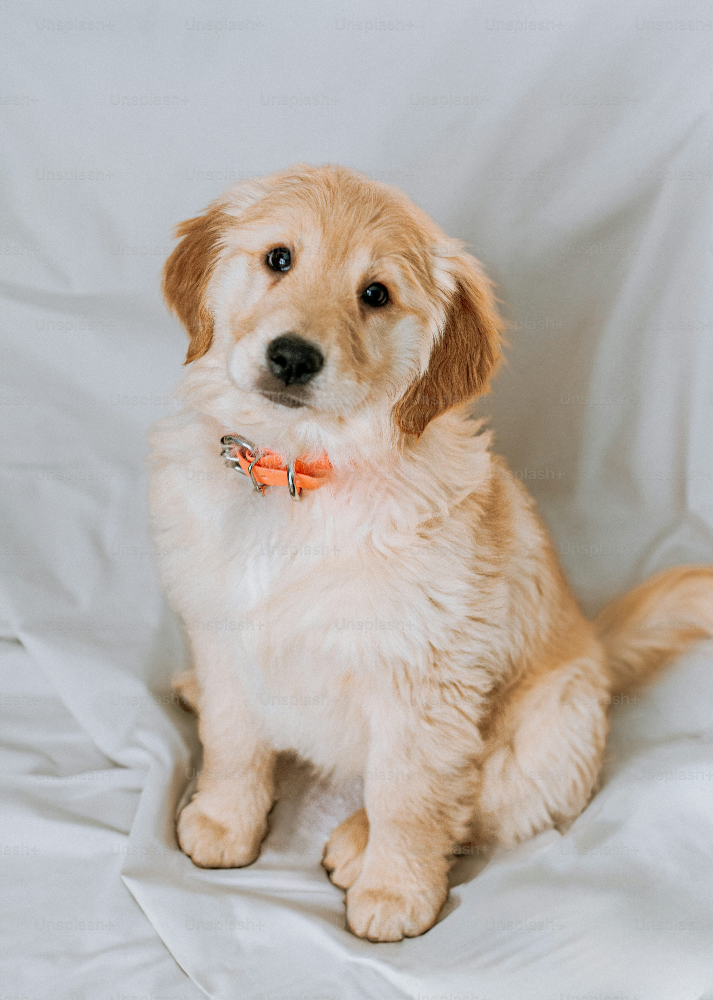

In [ ]:
!curl -o dog.jpg "https://plus.unsplash.com/premium_photo-1694819488591-a43907d1c5cc?fm=jpg&q=60&w=3000&ixlib=rb-4.1.0&ixid=M3wxMjA3fDB8MHxzZWFyY2h8MXx8Y3V0ZSUyMGRvZ3xlbnwwfHwwfHx8MA%3D%3D" # Dog
img = Image.open('dog.jpg', )
img
# image_url_2 = "https://images.pexels.com/photos/2071882/pexels-photo-2071882.jpeg?auto=compress&cs=tinysrgb&dpr=1&w=500" # Cat

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 64755  100 64755    0     0   595k      0 --:--:-- --:--:-- --:--:--  596k


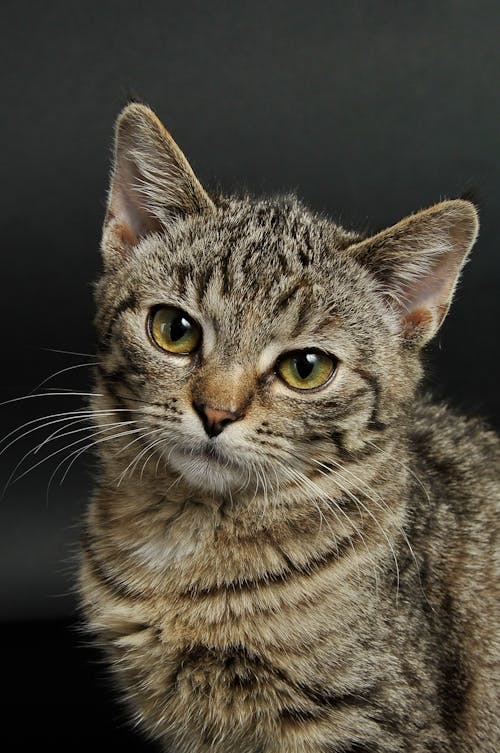

In [13]:
!curl -o cat.jpg "https://images.pexels.com/photos/2071882/pexels-photo-2071882.jpeg?auto=compress&cs=tinysrgb&dpr=1&w=500" # Cat
img = Image.open('cat.jpg', )
img
# image_url_2 = 

## 3. !! Exercise: Product Description from Image !!

Use Gemini to analyze an image of a product and generate a detailed description, including features, use cases, and a marketing slogan.

Tasks:
- Find an image URL of a product (e.g., a backpack, a mug, a piece of electronics).
- Use the `requests` library to get the image content from the URL.
- Create a `types.Part` object from the image bytes.
- Create a text `types.Part` object containing a prompt that asks the model about the Product. 
- Call `client.models.generate_content()` with the `MODEL_ID` and a list containing your text prompt part and the image part.

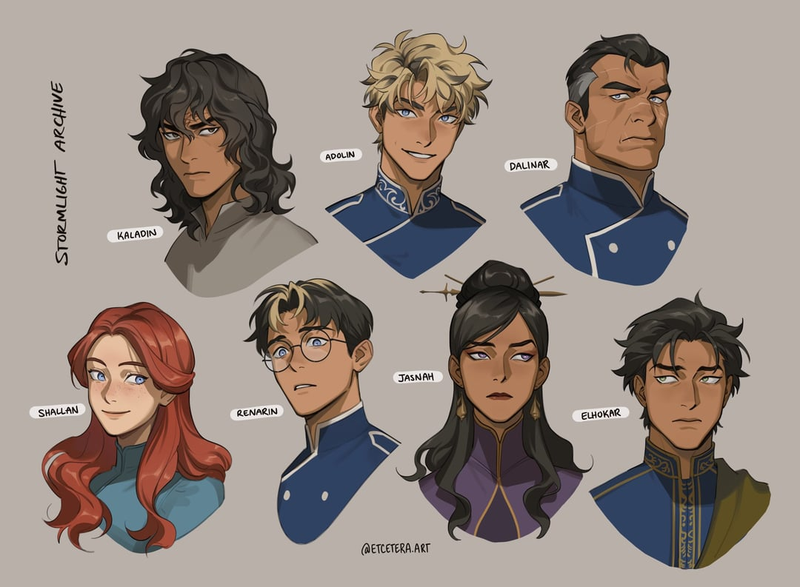

In [25]:
from PIL import Image
import requests
from io import BytesIO

# URL original (puede devolver .webp)
image_url = "https://preview.redd.it/stormlight-archive-characters-anime-style-v0-sj8m0bo9ty5e1.jpg?width=1080&crop=smart&auto=webp&s=76363ce821e4a340b55a70c706fecf042182c6a4"

# Descargar imagen
response = requests.get(image_url)
img = Image.open(BytesIO(response.content))
# Resize the image to a reasonable display size while maintaining aspect ratio

# Convertir y guardar como JPG
img.convert("RGB").save("stormlight.jpg", "JPEG")
max_size = (800, 800)
img.thumbnail(max_size, Image.Resampling.LANCZOS)
img

In [ ]:
# TODO
response_multi = client.models.generate_content(
    model=MODEL_ID,
    contents=[
        "Who is the main character in this image?",
        "Image 1:", types.Part.from_bytes(data=response.content, mime_type="image/jpeg")
    ]
)
print(response_multi.text)

The image displays several main characters from Brandon Sanderson's "Stormlight Archive" series.

While the series has multiple primary protagonists with rotating perspectives, the characters most consistently considered main characters across the books and arguably the most central to the overall narrative are:

*   **Kaladin** (top left)
*   **Shallan** (bottom left)
*   **Dalinar** (top right)

The other characters shown – Adolin, Renarin, Jasnah, and Elhokar – are also very important to the story, with Jasnah's role becoming more prominent in later books.

If forced to pick just one, **Kaladin** is often seen as the primary main character or one of the central anchors of the series.


## 4. Audio Understanding

Gemini can process audio files for transcription, content analysis, speaker identification, and audio summarization. This is particularly useful for podcasts, meetings, interviews, and voice memos.

**Supported audio formats**: MP3, WAV, FLAC, AAC, and other common formats

In [26]:
file_path = "../assets/data/audio.mp3"

file_id = client.files.upload(file=file_path)

# Generate a structured response using the Gemini API
prompt = """Generate a transcript of the episode. Include timestamps and identify speakers.

Speakers:
- John

eg:
[00:00] Brady: Hello there.
[00:02] Tim: Hi Brady.

It is important to include the correct speaker names. Use the names you identified earlier. If you really don't know the speaker's name, identify them with a letter of the alphabet, eg there may be an unknown speaker 'A' and another unknown speaker 'B'.

If there is music or a short jingle playing, signify like so:
[01:02] [MUSIC] or [01:02] [JINGLE]

If you can identify the name of the music or jingle playing then use that instead, eg:
[01:02] [Firework by Katy Perry] or [01:02] [The Sofa Shop jingle]

If there is some other sound playing try to identify the sound, eg:
[01:02] [Bell ringing]

Each individual caption should be quite short, a few short sentences at most.

Signify the end of the episode with [END].

Don't use any markdown formatting, like bolding or italics.

Only use characters from the English alphabet, unless you genuinely believe foreign characters are correct.

It is important that you use the correct words and spell everything correctly. Use the context of the podcast to help.
If the hosts discuss something like a movie, book or celebrity, make sure the movie, book, or celebrity name is spelled correctly."""
audio_part = types.Part.from_uri(file_uri=file_id.uri, mime_type=file_id.mime_type)

response = client.models.generate_content(
    model=MODEL_ID,
    contents=[prompt, audio_part]
)
print(response.text)

[00:00] John: If the Porsche Macan has proven anything, it's that the days of sacrificing performance for practicality are gone.
[00:06] John: Long gone.
[00:08] John: Engineered to deliver a driving experience like no other, the Macan has demonstrated excellence in style and performance, to become the leading sports car in its class.
[00:17] John: So don't let those five doors fool you.
[00:19] John: Once you're in the driver's seat, one thing will become immediately clear.
[00:22] [Car engine roaring]
[00:24] John: This is a Porsche.
[00:26] John: The Macan, now leasing from 3.99%.
[00:29] John: Conditions apply.
[00:31] [Jingle]
[END]


## 5. Video Understanding

Gemini can process video files to understand their content, analyze scenes, identify objects and actions, and provide detailed summaries.

**Video capabilities:**
- Scene analysis and summarization
- Object and action recognition
- Temporal understanding (what happens when)
- Content extraction and key moments
- YouTube video analysis

In [27]:
from time import sleep

video_path = "../assets/data/standup.mp4"

video_file_id = client.files.upload(file=video_path)
def wait_for_file_ready(file_id):
    while file_id.state == "PROCESSING":
        sleep(1)
        file_id = client.files.get(name=file_id.name)
        wait_for_file_ready(file_id)
    return file_id

video_file_id = wait_for_file_ready(video_file_id)


prompt = "Describe the main events in this video. What is the primary subject?"
video_part = types.Part.from_uri(file_uri=video_file_id.uri, mime_type=video_file_id.mime_type)



# TODO: Call client.models.generate_content() to analyze the video.
# The contents should be a list containing the prompt and video_part.
# response = client.models.generate_content(
#     model=MODEL_ID,
#     contents=[..., ...]
# )
# print(response.text)

response = client.models.generate_content(
    model=MODEL_ID,
    contents=[prompt, video_part]
)
print(response.text)

The video features a man standing on a stage, holding a microphone, facing an audience. A brick wall serves as the backdrop, and some chairs are visible to his left. He is performing, delivering what appears to be a stand-up comedy routine. He tells a joke, culminating in a punchline about a "shit-zu" dog. Upon delivering the joke, he smiles broadly as the audience responds with laughter.

The primary subject of the video is a male comedian performing a stand-up routine.


### YouTube Video Analysis

The Gemini API supports direct YouTube URL analysis, which is very convenient for content analysis:

In [28]:
# Analyze a YouTube video directly
youtube_url = "https://www.youtube.com/watch?v=dwgmfSOZNoQ"  # Google Cloud Next '25 Opening Keynote

youtube_part = genai.types.Part(
    file_data=genai.types.FileData(file_uri=youtube_url)
)
prompt = "What was the biggest Gemini announcement in this video?"

response = client.models.generate_content(
    model=MODEL_ID,
    contents=[prompt, youtube_part]
)

print(response.text)

The biggest Gemini announcement in this video was the **availability of Gemini on Google Distributed Cloud** (starting at 3:10). This allows Gemini to run locally in air-gapped and connected environments, bringing AI capabilities to regulated industries and countries directly on-premises.

Other significant Gemini-related announcements included:
*   **Gemini 2.5 Pro** is now available for everyone in AI Studio, Vertex AI, and the Gemini app (as a preview, starting at 1:43).
*   **New Gemini 2.5 Flash** (a low-latency, cost-efficient model) is coming soon (starting at 1:54).
*   **New Gemini Code Assist Agents** are being introduced to help with tasks across the software development life cycle (starting at 7:57).
*   **Gemini in Security** is integrated into Google's Unified Security solution to enhance threat detection and security operations (starting at 8:28).


## 6. !! Exercise: Summarize a YouTube Video !!

Analyze a YouTube video using its URL and generate a summary or transcript.

Tasks:
- Find a YouTube video URL (e.g., a tutorial, news segment, or educational video).
- Create a `genai.types.Part` object from the YouTube URL. You can use `genai.types.Part(file_data=genai.types.FileData(file_uri=youtube_url))` for this.
- Define a prompt asking the model to perform a task, such as summarizing the video.
- Call `client.models.generate_content()` with the `MODEL_ID`, your prompt, and the YouTube video part.

In [ ]:
# TODO:
youtube_url = "https://www.youtube.com/watch?v=HIS5RdYmwBs"

youtube_part = genai.types.Part(
    file_data=genai.types.FileData(file_uri=youtube_url)
)
prompt = "What was the main cause for the murder of Dalinar?"

response = client.models.generate_content(
    model=MODEL_ID,
    contents=[prompt, youtube_part]
)

print(response.text)

Based on the video provided and the events described in Brandon Sanderson's *The Stormlight Archive*, **Dalinar Kholin was not murdered.**

The video explicitly details the assassination of **King Gavilar Kholin**, Dalinar's brother, which happened five years before the start of *The Way of Kings*.

The **main cause for Gavilar's murder** was his ambition to reignite the Desolations and bring back the Fused (the Parshendi's ancient "gods") by using Voidlight. He believed this would allow him and his kingdom to achieve a form of immortality or eternal glory.

Here's a breakdown of why different parties were involved in his assassination:

1.  **The Listeners (Parshendi):** Specifically, the Five (their ruling council, including Eshonai and Venli's mother) ordered the assassination. They saw Gavilar's plan to bring back their "gods" as a betrayal of their hard-won freedom and a catastrophic event that would plunge Roshar back into the endless cycle of Desolations. They wanted to stop him

**Try these variations:**
- Analyze a tutorial video and extract step-by-step instructions
- Summarize a news video and identify key facts vs. opinions
- Analyze a product review and extract pros/cons
- Process an educational video and create study notes

## 7. Working with PDF/Document Files

Gemini can extract information from PDFs and other document formats, making it excellent for document analysis, data extraction, and content summarization.

**Common use cases:**
- Invoice processing and data extraction
- Contract analysis and summarization
- Research paper analysis
- Form processing and validation
- Document classification and routing

In [30]:
pdf_file_path = "../assets/data/rewe_invoice.pdf"

pdf_file_id = client.files.upload(file=pdf_file_path)

prompt = "What is the total amount due?"
pdf_part = types.Part.from_uri(file_uri=pdf_file_id.uri, mime_type=pdf_file_id.mime_type)

response = client.models.generate_content(
    model=MODEL_ID,
    contents=[prompt, pdf_part]
)
print(response.text)

The total amount due is **22,67 EUR**.


## 7. Code 

Gemini is good at understanding and generating code. Let's use [gitingest](https://github.com/cyclotruc/gitingest) to chat with a GitHub repo:

In [31]:
%pip install gitingest

  Using cached click-8.2.1-py3-none-any.whl.metadata (2.5 kB)
  Using cached tiktoken-0.9.0-cp312-cp312-macosx_11_0_arm64.whl.metadata (6.7 kB)
  Using cached regex-2024.11.6-cp312-cp312-macosx_11_0_arm64.whl.metadata (40 kB)
Using cached click-8.2.1-py3-none-any.whl (102 kB)
Using cached tiktoken-0.9.0-cp312-cp312-macosx_11_0_arm64.whl (1.0 MB)
Using cached regex-2024.11.6-cp312-cp312-macosx_11_0_arm64.whl (284 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5/5 [gitingest]
Note: you may need to restart the kernel to use updated packages.


In [32]:
from gitingest import ingest_async

summary, tree, content = await ingest_async("https://github.com/philschmid/nextjs-gemini-2-0-pdf-structured-data")

In [33]:
print(summary)

Repository: philschmid/nextjs-gemini-2-0-pdf-structured-data
Files analyzed: 28

Estimated tokens: 13.7k


In [34]:
print(tree)

Directory structure:
└── philschmid-nextjs-gemini-2-0-pdf-structured-data/
    ├── README.md
    ├── Dockerfile
    ├── LICENSE
    ├── components.json
    ├── empty-module.ts
    ├── eslint.config.mjs
    ├── next.config.ts
    ├── package.json
    ├── postcss.config.mjs
    ├── tailwind.config.ts
    ├── tsconfig.json
    ├── app/
    │   ├── globals.css
    │   ├── layout.tsx
    │   ├── page.tsx
    │   └── api/
    │       ├── extract/
    │       │   └── route.ts
    │       └── schema/
    │           └── route.ts
    ├── components/
    │   ├── FileUpload.tsx
    │   ├── PdfViewer.tsx
    │   ├── PromptInput.tsx
    │   ├── ResultDisplay.tsx
    │   ├── providers.tsx
    │   └── ui/
    │       ├── button.tsx
    │       ├── card.tsx
    │       ├── input.tsx
    │       ├── popover.tsx
    │       ├── sheet.tsx
    │       └── textarea.tsx
    ├── lib/
    │   └── utils.ts
    └── public/



In [35]:
prompt = f"""Explain what repository is about:

Code:
{content}
"""

chat = client.chats.create(model=MODEL_ID)

response = chat.send_message(prompt)
print(response.text)

Based on the files provided, a **repository** (often shortened to "repo") is essentially a **centralized storage location for all the files, code, documentation, and version history related to a specific software project.**

Think of it like this:

1.  **A Project Container:** The entire collection of files you've provided (`README.md`, `Dockerfile`, `package.json`, `LICENSE`, the `app/` directory containing the source code, etc.) constitutes a single software project: "PDF to Structured Data with Next.js and Gemini 2.0". All these files, working together, define the application.

2.  **Version Control System (VCS) Home:** In modern software development, repositories are almost always managed by a **Version Control System** like Git. This system tracks every change made to every file over time.

**What the provided files tell us about this concept:**

*   **`README.md`**: This is the "front page" of the repository. It describes what the project is, how it works, its features, and, most

In [36]:
response = chat.send_message("How are the schemas defined?")
print(response.text)

In this project, JSON schemas are **dynamically defined and generated at runtime** based on natural language input provided by the user. They are not hardcoded or pre-defined in static files.

Here's a breakdown of how the schemas are defined:

1.  **User Prompt as Input:**
    *   The user provides a natural language description of the data they want to extract from a PDF. This happens in the `PromptInput.tsx` component, where they type their request into a `Textarea`.
    *   Example user prompt: "Cookie Recipes" or "Book with title, author, and publication year."

2.  **API Endpoint for Schema Generation (`/api/schema/route.ts`):**
    *   When the user submits their prompt, the frontend (`app/page.tsx`) makes a `POST` request to the `/api/schema` endpoint.
    *   This endpoint is responsible for taking the user's prompt and converting it into a JSON schema.

3.  **Google Gemini 2.0 and a "Meta-Prompt":**
    *   The core of schema definition lies within the `META_PROMPT` string in

In [37]:
response = chat.send_message("Update all schema route to use the new Gemini 2.5 models, `gemini-2.5-flash-preview-05-20`. Return only the updated file.")
print(response.text)

```typescript
import { NextResponse } from "next/server";
import { GoogleGenerativeAI } from "@google/generative-ai";

const genAI = new GoogleGenerativeAI(process.env.GEMINI_API_KEY!);
const MODEL_ID = "gemini-2.5-flash-preview-05-20"; // Updated to Gemini 2.5 model

const META_PROMPT = `
You are a JSON Schema expert. Your task is to create JSON schema based on the user input. The schema will be used for extra data.  

You must also make sure:
- All fields in an object are set as required
- All objects must have properties defined
- Order matters! If the values are dependent or would require additional information, make sure to include the additional information in the description. Same counts for "reasoning" or "thinking" should come before the conclusion.
- $defs must be defined under the schema param
- Return only the schema JSON not more, use \`\`\`json to start and \`\`\` to end the JSON schema

Restrictions:
- You cannot use examples, if you think examples are helpful include th

## 9. Image Generation

Generate high-quality images using Gemini's image generation capabilities. This feature is perfect for creating visual content, prototypes, marketing materials, and creative projects.

**Image Generation Features:**
- Text-to-image generation
- Style control through prompts
- High-resolution output
- SynthID watermarking for authenticity
- Multiple aspect ratios and sizes

In [52]:
from PIL import Image
from io import BytesIO


prompt_text = "A photo of a cat"

response = client.models.generate_content(
    model="gemini-2.0-flash-preview-image-generation",
    contents=prompt_text,
    config=types.GenerateContentConfig(
      response_modalities=['TEXT', 'IMAGE']
    )
)

# Process the response
image_saved = False
for part in response.candidates[0].content.parts:
  if part.text is not None:
    print(f"Text response: {part.text}")
  elif part.inline_data is not None and part.inline_data.mime_type.startswith('image/'):
      image = Image.open(BytesIO(part.inline_data.data))
      image_filename = 'gemini_generated_image.png'
      image.save(image_filename)

image

ClientError: 404 NOT_FOUND. {'error': {'code': 404, 'message': 'models/gemini-2.0-flash-preview-image-generation is not found for API version v1beta, or is not supported for generateContent. Call ListModels to see the list of available models and their supported methods.', 'status': 'NOT_FOUND'}}

**Image Generation Tips:**
- Be specific about style (photorealistic, illustration, cartoon, etc.)
- Include lighting and mood descriptors
- Specify composition details (close-up, wide shot, etc.)
- Mention art styles or references when relevant
- Consider aspect ratio and resolution needs

> **Note**: All generated images include a SynthID watermark for authenticity verification. More details in the [official documentation](https://ai.google.dev/gemini-api/docs/image-generation).

## 10. Text to Speech

Convert text into natural-sounding speech with controllable voice characteristics. This feature enables creating audio content, accessibility features, and interactive applications.

**TTS Capabilities:**
- Multiple voice options and styles
- Controllable pace, tone, and emotion
- Single-speaker and multi-speaker audio
- High-quality audio output
- Natural language voice direction

For this example, we'll use the `gemini-2.5-flash-preview-tts` model to generate single-speaker audio. You'll need to set the `response_modalities` to `["AUDIO"]` and provide a `SpeechConfig`.

In [45]:
%pip install soundfile numpy

  Using cached numpy-2.2.6-cp312-cp312-macosx_14_0_arm64.whl.metadata (62 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 37.3 MB/s eta 0:00:00
Using cached numpy-2.2.6-cp312-cp312-macosx_14_0_arm64.whl (5.1 MB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4/4 [soundfile]/4 [cffi]]
Note: you may need to restart the kernel to use updated packages.


In [46]:
import soundfile as sf
import numpy as np
from IPython.display import Audio, display

text_to_speak = "Say cheerfully: AI Eingeering Worlds Fair is the best conference in the world!"

response_tts = client.models.generate_content(
   model="gemini-2.5-flash-preview-tts", # Specific model for TTS
   contents=text_to_speak,
   config=types.GenerateContentConfig(
      response_modalities=["AUDIO"],
      speech_config=types.SpeechConfig(
         voice_config=types.VoiceConfig(
            prebuilt_voice_config=types.PrebuiltVoiceConfig(
               voice_name='Kore', # Choose from available prebuilt voices
            )
         )
      ),
   )
)

audio_array = np.frombuffer(response_tts.candidates[0].content.parts[0].inline_data.data, dtype=np.int16)
sf.write("generated_speech.wav", audio_array, 24000)
display(Audio("generated_speech.wav"))

## !! Exercise: Avatar Generation !!


Combine image generation and text-to-speech capabilities to create a visual avatar and an audio introduction for it.


1.  **Generate an Avatar Image:**
    - Write a descriptive prompt for an avatar image (e.g., "A friendly, futuristic robot assistant with a welcoming smile, digital art style, high resolution").
    - Use `client.models.generate_content()` with the model `gemini-2.0-flash-preview-image-generation`.
    - Set `response_modalities=['TEXT', 'IMAGE']` in `GenerateContentConfig`.
    - Process the response to extract the image data (from `part.inline_data.data` where `mime_type` starts with `image/`).
    - Save the image (e.g., as `generated_avatar.png`) using `PIL.Image` and `BytesIO`.
    - Display the generated image.
2.  **Create an Introduction Text:**
    - Write a short introductory sentence for your avatar (e.g., "Hello! I am Vision, your friendly AI assistant. I'm excited to help you generate amazing things!").
3.  **Generate Speech for the Introduction:**
    - Use `client.models.generate_content()` with the model `gemini-2.5-flash-preview-tts`.
    - For the `contents`, you can augment the introduction text with a description of the avatar to influence the voice (e.g., f"Say in a voice based on this image description {{your_image_prompt}}: {{your_introduction_text}}").
    - Configure `GenerateContentConfig` with `response_modalities=["AUDIO"]`.
    - Set up `speech_config` within the `GenerateContentConfig` to select a `prebuilt_voice_config` (e.g., `voice_name='Puck'`).
    - Process the response to get the audio data (from `part.inline_data.data`).
    - Convert the audio data to a NumPy array and save it as a WAV file (e.g., `avatar_introduction.wav`) using `soundfile`.
    - Provide a way to play the audio (e.g., `IPython.display.Audio`).

In [53]:
# TODO:
from PIL import Image
from io import BytesIO


image_prompt = "A friendly, futuristic robot assistant with a welcoming smile, digital art style, high resolution"
generate_image = False
if generate_image:
  response = client.models.generate_content(
      model="gemini-2.0-flash-preview-image-generation",
      contents=prompt_text,
      config=types.GenerateContentConfig(
        response_modalities=['TEXT', 'IMAGE']
      )
  )

  # Process the response
  image_saved = False
  for part in response.candidates[0].content.parts:
    if part.text is not None:
      print(f"Text response: {part.text}")
    elif part.inline_data is not None and part.inline_data.mime_type.startswith('image/'):
        image = Image.open(BytesIO(part.inline_data.data))
        image_filename = 'generated_avatar.png'
        image.save(image_filename)


intro_prompt = "Hello! I am Vision, your friendly AI assistant. I'm excited to help you generate amazing things!"

text_to_speak = f"Say in a voice based on this image description {image_prompt}: {intro_prompt}"

response_tts = client.models.generate_content(
   model="gemini-2.5-flash-preview-tts", # Specific model for TTS
   contents=text_to_speak,
   config=types.GenerateContentConfig(
      response_modalities=["AUDIO"],
      speech_config=types.SpeechConfig(
         voice_config=types.VoiceConfig(
            prebuilt_voice_config=types.PrebuiltVoiceConfig(
               voice_name='Puck', # Choose from available prebuilt voices
            )
         )
      ),
   )
)

audio_array = np.frombuffer(response_tts.candidates[0].content.parts[0].inline_data.data, dtype=np.int16)
sf.write("avatar_introduction.wav", audio_array, 24000)
display(Audio("avatar_introduction.wav"))

## Recap & Next Steps

**What You've Learned:**
- Image understanding with single and multiple image analysis for various use cases
- Audio processing including speech transcription and audio content analysis
- Video analysis for scene understanding and YouTube content processing
- Document processing with PDF analysis and structured data extraction
- Code understanding for repository analysis and code review
- Creative generation with image creation and text-to-speech synthesis
- Multimodal integration combining different content types for rich applications
- File API usage for efficient handling of large files and reusable content

**Key Takeaways:**
- Use File API for large files (>20MB) and content you'll reuse multiple times
- Implement comprehensive error handling for network and API operations
- Structure prompts clearly and specifically for consistent, high-quality outputs
- Monitor token usage across different modalities for effective cost control
- Consider user experience and processing time for multimedia operations

**Next Steps:** Continue with [Part 3: Structured Outputs, Function Calling & Tools](https://github.com/philschmid/gemini-2.5-ai-engineering-workshop/blob/main/notebooks/03-structured-outputs-function-calling-tools.ipynb) [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/philschmid/gemini-2.5-ai-engineering-workshop/blob/main/notebooks/03-structured-outputs-function-calling-tools.ipynb)

**More Resources:**
- [Vision Understanding Documentation](https://ai.google.dev/gemini-api/docs/vision?lang=python)
- [Audio Understanding Documentation](https://ai.google.dev/gemini-api/docs/audio?lang=python)
- [Image Generation Guide](https://ai.google.dev/gemini-api/docs/image-generation)
- [Text-to-Speech Documentation](https://ai.google.dev/gemini-api/docs/speech-generation)